# Principle of Data Science Assignment

##### - By Mitali Patle (22537720)

This notebook contains all the Data processing , data engineering and analysis of the Dataset provide

#### Table of Content

1. Data Exploration
2. Feature Enigeering
3. Visual Analysis of data

### Data Exploration And Feature Engineering

##### Importing required libraries

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
sns.set(
    { "figure.figsize": (8, 6) },
    style='ticks',
    color_codes=True,
    font_scale=0.8
)
%config InlineBackend.figure_formats = set(('retina', 'svg'))

##### Imporing Data Set

In [3]:
ds=pd.read_csv("adverts.csv")

In [4]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 402005 entries, 0 to 402004
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       402005 non-null  int64  
 1   mileage                401878 non-null  float64
 2   reg_code               370148 non-null  object 
 3   standard_colour        396627 non-null  object 
 4   standard_make          402005 non-null  object 
 5   standard_model         402005 non-null  object 
 6   vehicle_condition      402005 non-null  object 
 7   year_of_registration   368694 non-null  float64
 8   price                  402005 non-null  int64  
 9   body_type              401168 non-null  object 
 10  crossover_car_and_van  402005 non-null  bool   
 11  fuel_type              401404 non-null  object 
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 34.1+ MB


Here we can observe there are 12 columns in our data set out of which 4 are quantaive and others are categorical data. From this we need to identify which all the fearures and which will be our target.

In [5]:
ds.sample(3)

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
141837,202007141228787,105000.0,63,Silver,Audi,A3,USED,2014.0,7995,Hatchback,False,Petrol
357700,202004178975530,7071.0,69,Black,BMW,3 Series,USED,2020.0,34994,Saloon,False,Diesel
345922,202010275499800,62000.0,14,Blue,Audi,A3,USED,2014.0,10990,Hatchback,False,Petrol


#### Identifying the range and shape of data

In [6]:
ds.shape

(402005, 12)

In [7]:
ds.describe()

,public_reference,mileage,year_of_registration,price
count,4.020050e+05,401878.000000,368694.000000,4.020050e+05
mean,2.020071e+14,37743.595656,2015.006206,1.734197e+04
std,1.691662e+10,34831.724018,7.962667,4.643746e+04
min,2.013072e+14,0.000000,999.000000,1.200000e+02
25%,2.020090e+14,10481.000000,2013.000000,7.495000e+03
50%,2.020093e+14,28629.500000,2016.000000,1.260000e+04
75%,2.020102e+14,56875.750000,2018.000000,2.000000e+04
max,2.020110e+14,999999.000000,2020.000000,9.999999e+06


Using describe we can check the range of all the quantitavie data

#### Identifying features and Traget

We have the following data of a vehicle- 
1.	Public reference 
2.	Mileage
3.	Registration code
4.	Standard Color 
5.	Brand
6.	Model
7.	Vehicle Condition
8.	Year of registration 
9.	Price 
10.	Body type
11.	Cross over of Car or Van
12.	Fuel type 

Out of all above, our target will be Price, we will use different features to predict and make future analysis of Price of the vehicle. 
Therefore, here our features will be -Brand, Model, Mileage, Vehicle condition, Year of Registration, Body Type,Fuel type and Cross over Car or Van.


In [8]:
features=ds.drop(columns=['public_reference','reg_code','price'])

In [9]:
target=ds.drop(columns=['public_reference','reg_code','mileage','standard_colour','standard_make','standard_model','vehicle_condition','year_of_registration','body_type','fuel_type','crossover_car_and_van'])

In [10]:
features.sample(5)

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,body_type,crossover_car_and_van,fuel_type
102316,44000.0,Grey,Fiat,500X,USED,2016.0,SUV,False,Petrol
296778,115000.0,White,Nissan,Juke,USED,2012.0,SUV,False,Diesel
316519,30285.0,Grey,MINI,Hatch,USED,2014.0,Hatchback,False,Diesel
358598,37445.0,Silver,Audi,A1,USED,2016.0,Hatchback,False,Diesel
248198,7947.0,Blue,Hyundai,i10,USED,2019.0,Hatchback,False,Petrol


In [11]:
target.sample(5)

,price
90897,4989
188391,9959
69844,11295
90555,41990
205799,17670


#### Identifying Nan values


The data contains lots of Null values, we need to identify these null values and remove or substitute these null values with a meaningfull data.

In [12]:
dss=features.sample(5000) #taking small part of data for visualization

<AxesSubplot:>

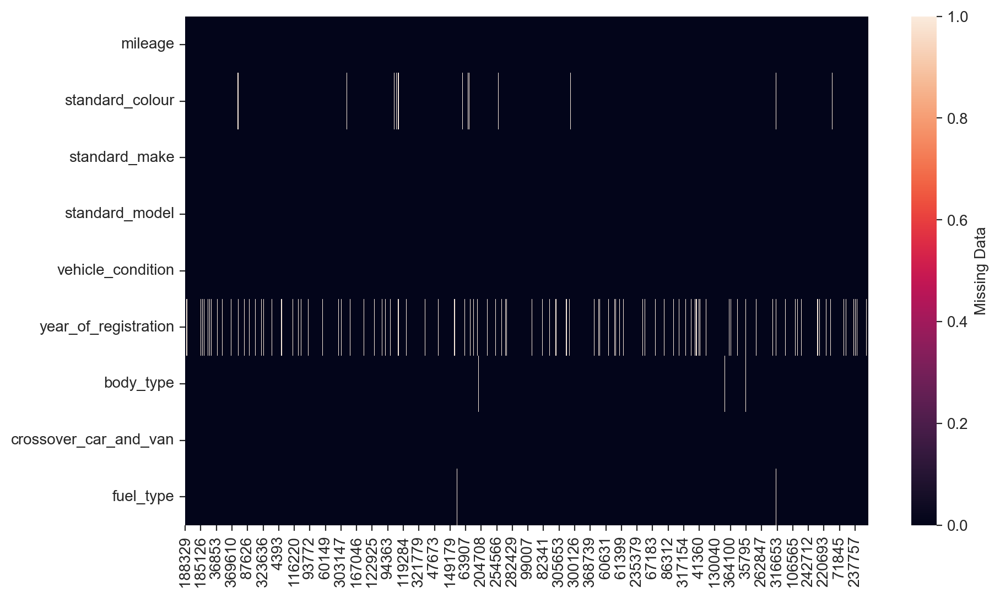

In [13]:
plt.figure(figsize=(10,6))
sns.heatmap(dss.isna().transpose(),
            cbar_kws={'label': 'Missing Data'})

The above heatmap shows us that there are lot of Null values in features, to be precise have total null values as follows-

In [14]:
plt.clf() #to clearup the memory

<Figure size 800x600 with 0 Axes>

In [15]:
features.isna().sum()

mileage                    127
standard_colour           5378
standard_make                0
standard_model               0
vehicle_condition            0
year_of_registration     33311
body_type                  837
crossover_car_and_van        0
fuel_type                  601
dtype: int64

#### Removing NaN values form the features

Either way to remove null values is to drop the rows with null value or subsitute them with a meaning value. Here we will be replacing our Null values with the mean of the data so that we can work with whole data and there is no data loss in any case.

In [16]:
features['mileage']= features['mileage'].fillna(features['mileage'].mean())

In [17]:
features['year_of_registration']=features['year_of_registration'].fillna(features['year_of_registration'].mean())
features['year_of_registration']=features['year_of_registration'].astype(int)

Body type,Fuel type and Standard colour are categorical values and hence we cannot fill the null values with mean , so in this case we will be replacing the Null values with the values which have maximum occurances maximum occurance

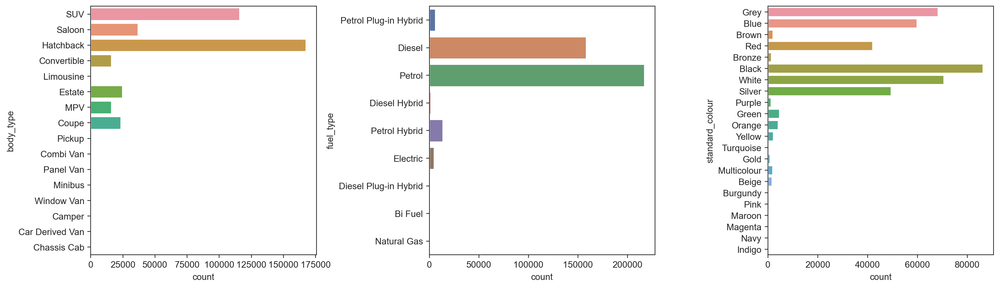

In [18]:
plt.figure(figsize=(18,5))
plt.subplots_adjust(wspace=0.5)
plt.subplot(1,3,1)
sns.countplot(y='body_type',data=features)

plt.subplot(1,3,2)
sns.countplot(y='fuel_type',data=features)

plt.subplot(1,3,3)
sns.countplot(y='standard_colour',data=features)

plt.savefig("Countplot.png")

From the above graph we can understand that the most common body type is "Hatchback" and the most common fuel type is "Petrol" hence we will replace the null values with "Hatchback"

In [19]:
plt.clf() #to clear up the memory

<Figure size 800x600 with 0 Axes>

In [20]:
features['body_type']=features['body_type'].fillna("Hatchback")

In [21]:
features['fuel_type']=features['fuel_type'].fillna("Petrol")

In [22]:
features['standard_colour']=features['standard_colour'].fillna("Black")

We have now cleaned all the null values from our features. 

In [23]:
advert=features.join(target)

In [24]:
advert.sample()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,body_type,crossover_car_and_van,fuel_type,price
18179,60777.0,Black,Mercedes-Benz,S Class,USED,2016,Saloon,False,Diesel,25000


In [25]:
dss=advert.sample(5000)
#taking smaller part of data to visualize

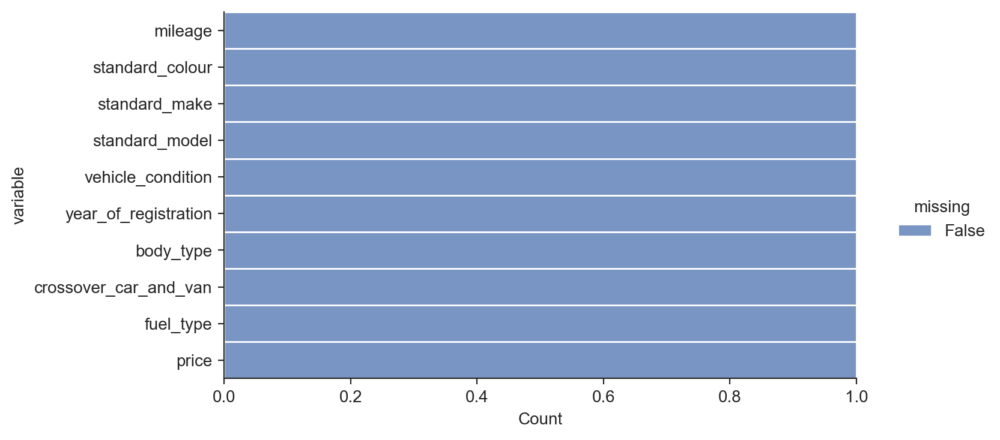

In [26]:
sns.displot(data=advert.isna().melt(value_name="missing"),y="variable",hue="missing",multiple="fill",aspect=2,height=3.75)


The above distpot shows us that there are no more null values in our dataset

In [27]:
advert.isna().sum() 

mileage                  0
standard_colour          0
standard_make            0
standard_model           0
vehicle_condition        0
year_of_registration     0
body_type                0
crossover_car_and_van    0
fuel_type                0
price                    0
dtype: int64

#### Detecting Outliers

As this is a huge dataset, there are lots of chances that if will have some outliers. We will now visualize if we have outliers in our data 

<AxesSubplot:xlabel='year_of_registration', ylabel='price'>

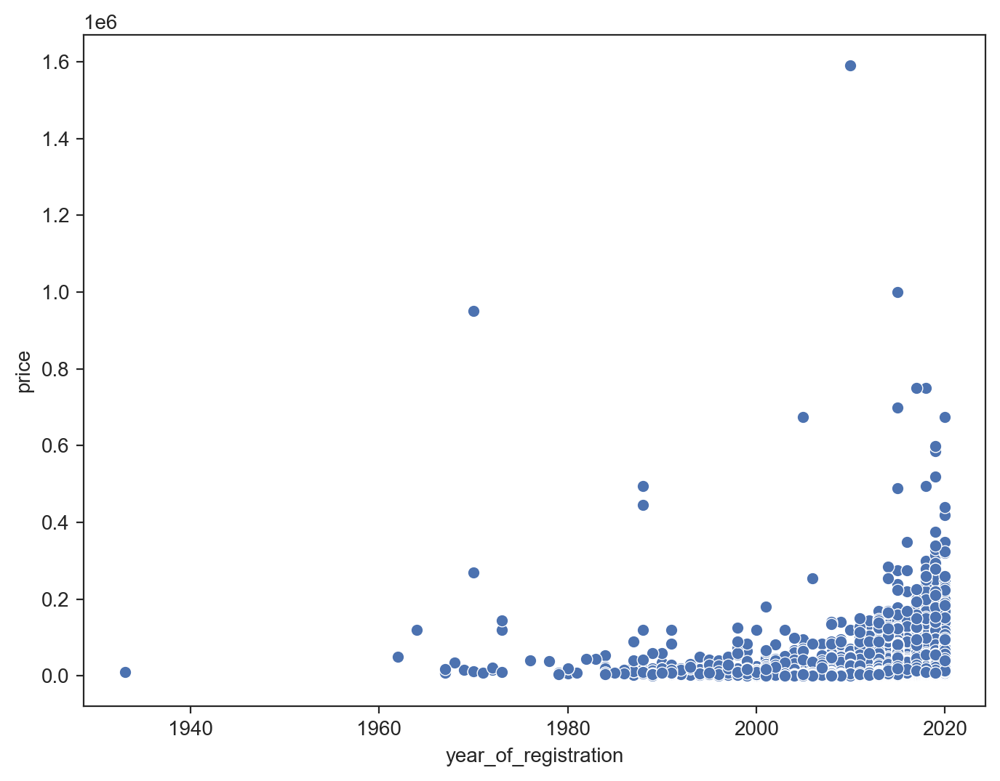

In [28]:
dss=advert.iloc[:40000,:]
sns.scatterplot(data=dss, x='year_of_registration',y='price')

<AxesSubplot:xlabel='mileage'>

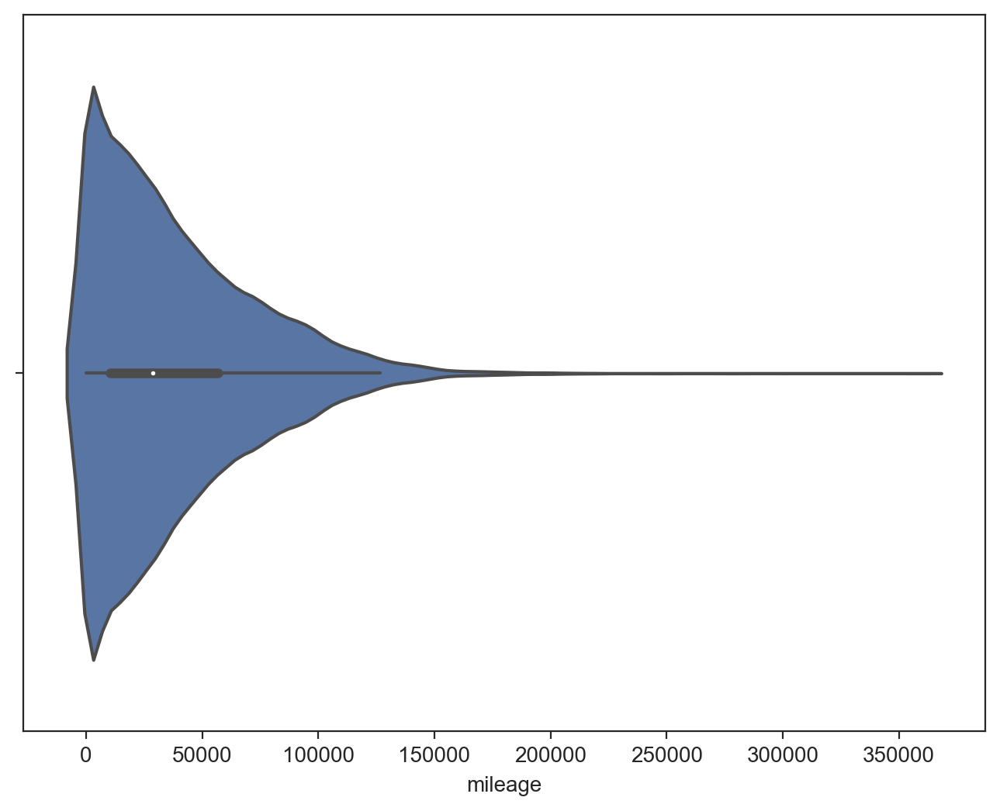

In [29]:
sns.violinplot(data= dss, x='mileage',hue='price')

The violin plot shows the distribution of the mileage and the box plot inside the violin shape shows the quartiles of the mileage. By observing the violin plot, we can see that there are many outlier as they falls outside the violin shape and also far from the box plot. 

In [30]:
plt.clf() #to clear up the memory

<Figure size 800x600 with 0 Axes>

#### Removing Outliers

We need to remove these outliers from our data, so that we can have a uniformly disctributed data to make our Ananlysis and prediction


In [31]:
def quantile(x):
    global Q1
    global Q3
    Q1=x.quantile(0.25)
    Q3=x.quantile(0.75)
    print('Q1=',Q1,'\nQ3=',Q3)
    global IQR 
    IQR = Q3 -Q1
    print ('IQR=', IQR)
    global Lowerlimit
    Lowerlimit= Q1 - 1.5*IQR
    global Upperlimit
    Upperlimit= Q3 + 1.5*IQR
    print ("Lower limit=", Lowerlimit, "\nUpper limit=", Upperlimit)

The above quantile function is a user defined function which will find the Upper and lower quantile and also the upper and lower limit values to trim the data

We will now find the upper and lower limit of price using quantile function

In [32]:
print("IQR for price-")
quantile(advert.price)


IQR for price-
Q1= 7495.0 
Q3= 20000.0
IQR= 12505.0
Lower limit= -11262.5 
Upper limit= 38757.5


Here the lower limit is a negative value which can be ignored, i.e our lower value of price can be considered as 0 and upper limit as 38757.5
Now we will trim the data and remove all those rows with price greated than upper limit

In [33]:
advert=advert.query("price <= @Upperlimit")

We will now find the upper and lower limit of year of registration using quantile function

In [34]:
print("IQR for Year of Registration-")
quantile(advert.year_of_registration)

IQR for Year of Registration-
Q1= 2013.0 
Q3= 2018.0
IQR= 5.0
Lower limit= 2005.5 
Upper limit= 2025.5


Here the upper and lower limit are 2005 and 2025 respectively, so our data should be in between them. We will remove the data below and above our limits.

In [35]:
advert=advert.query("year_of_registration <= @Upperlimit and year_of_registration >= @Lowerlimit")

In [36]:
print("IQR for Mileage-")
quantile(advert.mileage)

IQR for Mileage-
Q1= 12126.0 
Q3= 56492.0
IQR= 44366.0
Lower limit= -54423.0 
Upper limit= 123041.0


In [37]:
advert=advert.query("mileage <= @Upperlimit")

All the outliers are now removed from the dataset, now we can use this data to make our Analysis and prediction

In [38]:
 dss=advert.iloc[:40000,:]

<AxesSubplot:xlabel='year_of_registration', ylabel='price'>

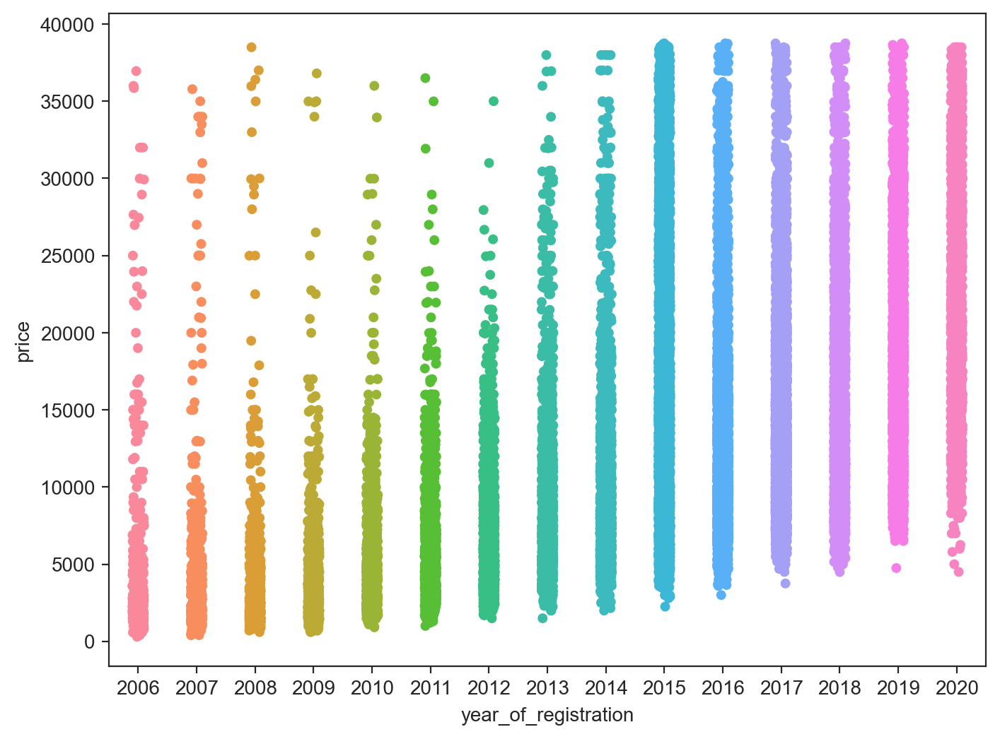

In [39]:
sns.stripplot(data=dss, x='year_of_registration',y='price')

The above stripplot shows that the data is now alligned and the outliers are now removed

<AxesSubplot:xlabel='mileage'>

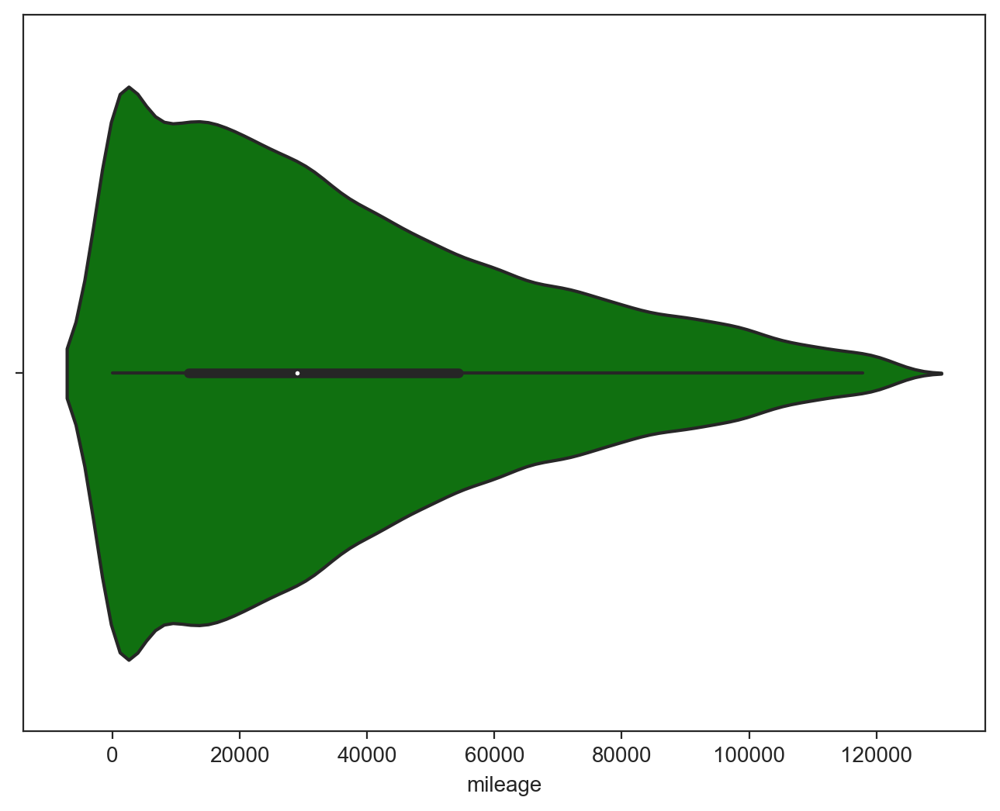

In [40]:
sns.violinplot(data=dss,x='mileage',color='green')

In [41]:
plt.clf() #to clear up the memory

<Figure size 800x600 with 0 Axes>

#### Finding correlations between the features and the targets

To find the correlation between features and target we need to convert the cateogorical data to numerical values

In [42]:

df=advert #taking backup of original data

In [43]:
df2_cat = df.astype({"standard_colour":"category","standard_make": "category", "standard_model": "category","vehicle_condition": "category","body_type": "category","crossover_car_and_van":"category","fuel_type": "category"})


In [44]:
df2_cat['standard_colour'] =df['standard_colour'].astype('category').cat.codes
df2_cat['standard_make'] =df['standard_make'].astype('category').cat.codes
df2_cat['standard_model'] =df['standard_model'].astype('category').cat.codes
df2_cat['vehicle_condition'] =df['vehicle_condition'].astype('category').cat.codes
df2_cat['body_type'] =df['body_type'].astype('category').cat.codes
df2_cat['crossover_car_and_van']=df['crossover_car_and_van'].astype('category').cat.codes
df2_cat['fuel_type'] =df['fuel_type'].astype('category').cat.codes


In [45]:
df2_cat.sample(5)

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,body_type,crossover_car_and_van,fuel_type,price
243298,8800.0,19,70,711,1,2017,13,0,1,14990
191028,6097.0,2,6,770,1,2019,7,0,4,30661
163658,59200.0,1,59,195,1,2016,13,0,1,7890
255090,10.0,8,74,341,0,2015,7,0,5,24000
17979,17296.0,17,6,728,1,2018,13,0,1,22999


In [46]:
corr = df2_cat.corr()

<AxesSubplot:>

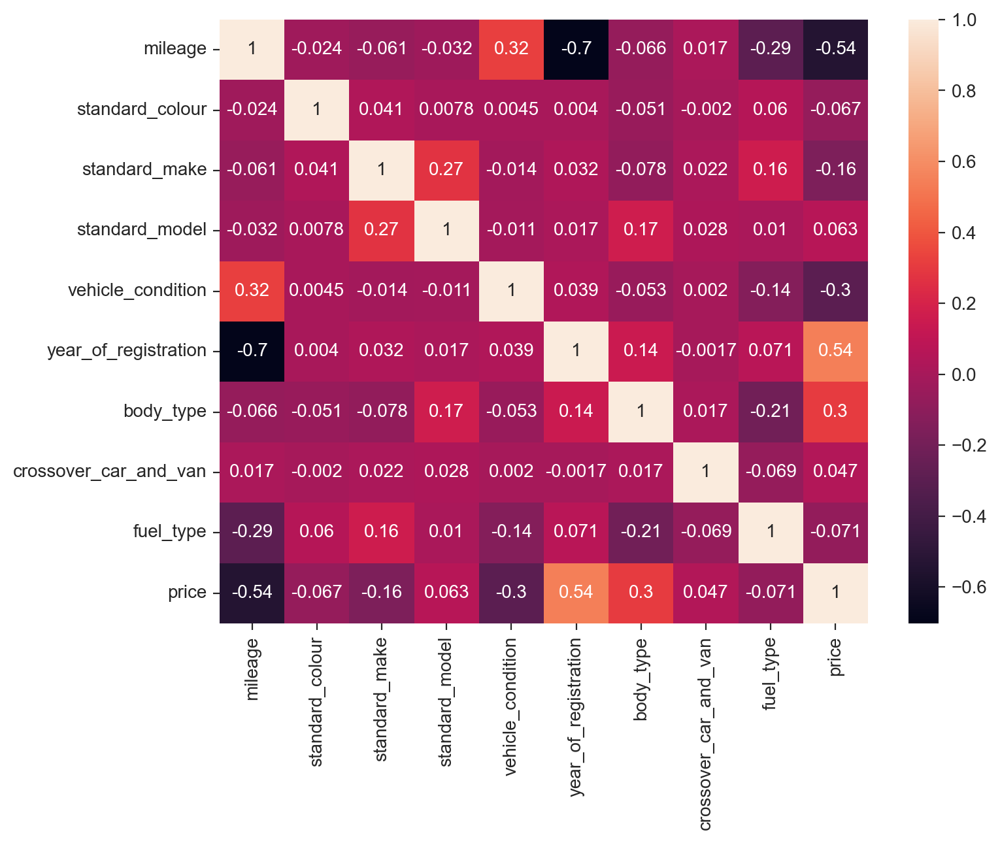

In [47]:
sns.heatmap(corr, annot=True)

The above heatmap shows us the correlation between all the features and correlation with price

The highest correlation is between price and year of registartion and then next between vehicle condition and mileage. Using this heatmap we will select our features with maximum correlationa and we will make our analysis.

In [48]:
advert.sample()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,body_type,crossover_car_and_van,fuel_type,price
3626,54500.0,Grey,SKODA,Fabia,USED,2013,Hatchback,False,Petrol,5950


### Visual Analysis

In [49]:
#dss=advert.iloc[:40000,:] #taking small part of data for visualization

Now with the help of differents plots we will try to visualize how the price of the vehicle varies with different categorical and quantative features

##### Price Vs Year of Registration

<AxesSubplot:xlabel='year_of_registration', ylabel='price'>

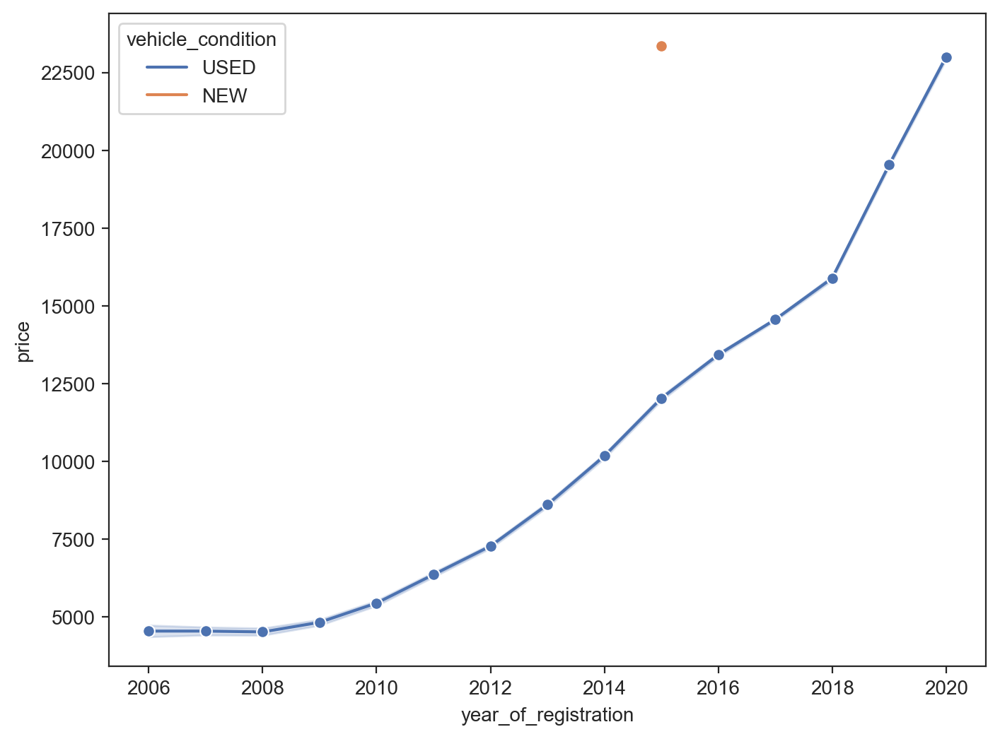

In [50]:
sns.lineplot(data=advert,x='year_of_registration',y='price',hue='vehicle_condition',marker= 'o')

 The above line plot shows us how, the price of the vehicle has increased over the years. New vehicles are only from the year 2015, no other vehicles where registered in any other year.

##### Mileage VS Price

In [51]:
dss=advert.sample(40000)

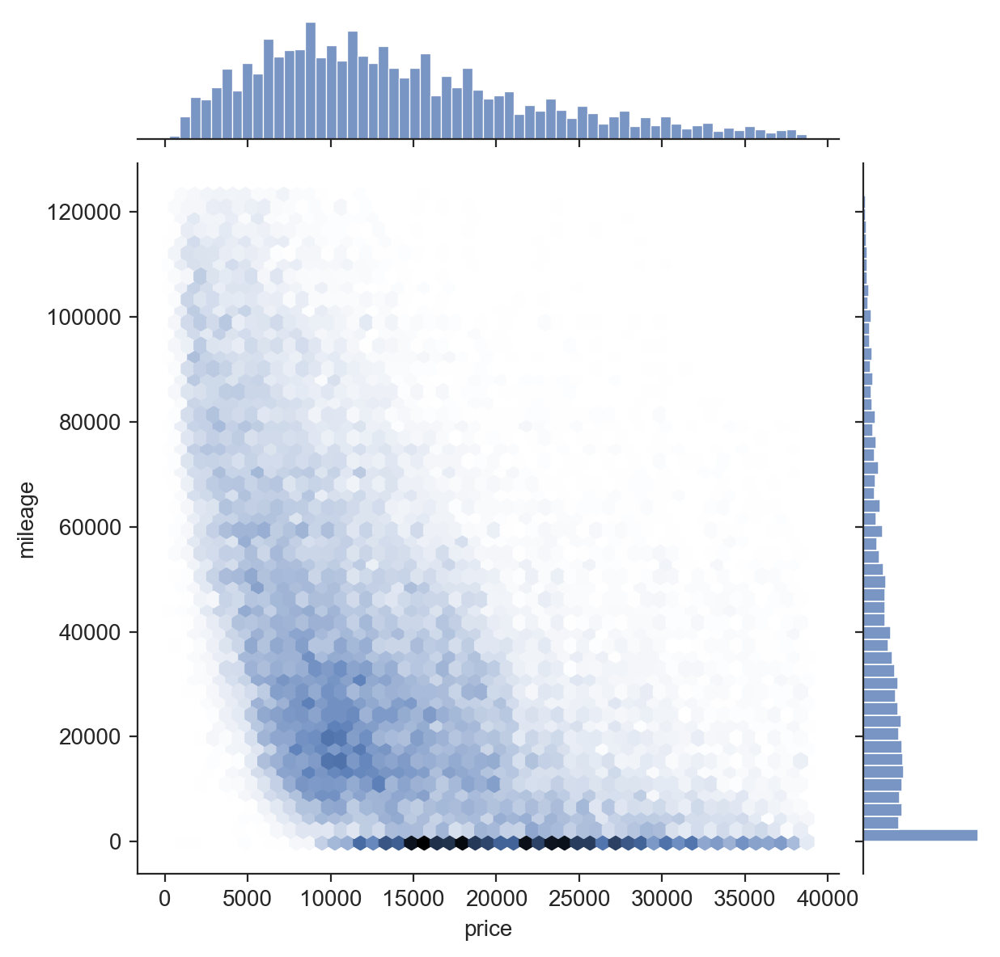

In [59]:
sns.jointplot(y = 'mileage', x = 'price',data = dss,kind = 'hex')

The Hexbin plot shows the relationship between the mileage and the price of a car.The plot shows the density of the points for price range, with the darker hexagons indicating a higher density of cars with lower mileage and high price. 


##### Body type Vs Year of registration and Price

In [220]:
price_details = (
advert.groupby( ['body_type', 'year_of_registration'])['price'].mean()
    .unstack('year_of_registration').fillna(advert['price'].mean())
    
)   

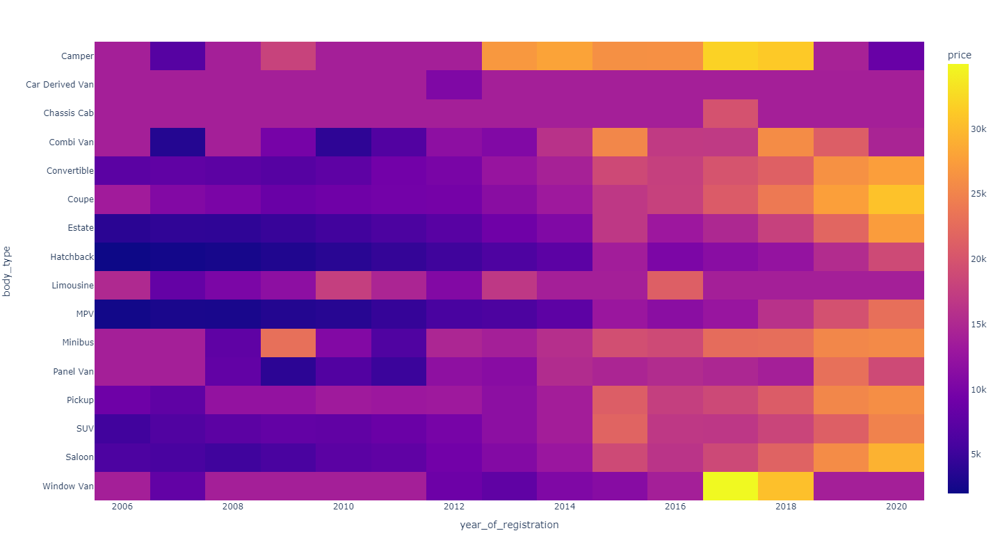

In [221]:
fig =px.imshow(price_details,labels=dict(x='year_of_registration', y='body_type', color='price'))
fig.update_layout(width=1000,height=800)
fig.show()

The above heatmap shows how the price of various vehicles has varied throughout the year 2006-2020 based on body type.

In [63]:
plt.clf()


<Figure size 800x600 with 0 Axes>

##### Body Type Vs Price

In [109]:
dss=advert.sample(50000)


<AxesSubplot:xlabel='body_type', ylabel='price'>

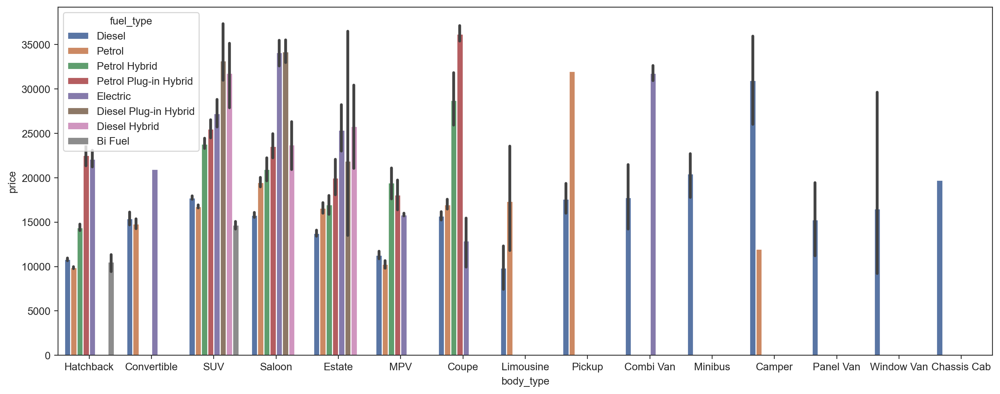

In [110]:
plt.figure(figsize=(16,6))
sns.barplot(data=dss, x='body_type',y='price',hue='fuel_type')

##### Body Type vs Cross over van and car & price

In [114]:
dss= advert.sample(40000)

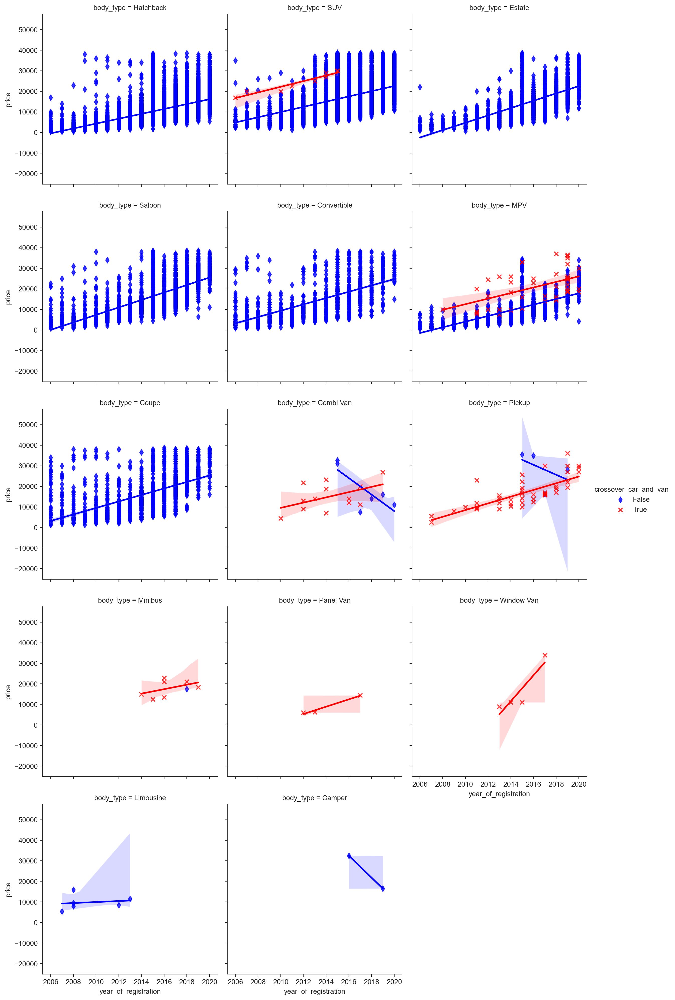

In [137]:
sns.lmplot(x='year_of_registration',y='price',data=dss, hue='crossover_car_and_van',markers=['d','x'], palette=['blue','red'],col='body_type',col_wrap=3,height=4)
plt.savefig("Body Type VS Cross Over C&V-Price")



The linear regression plot shows the relationship between Body type and Price and based on, if they are cross over of Car & Van.

##### Body type Vs Vehicle condition

<AxesSubplot:xlabel='body_type'>

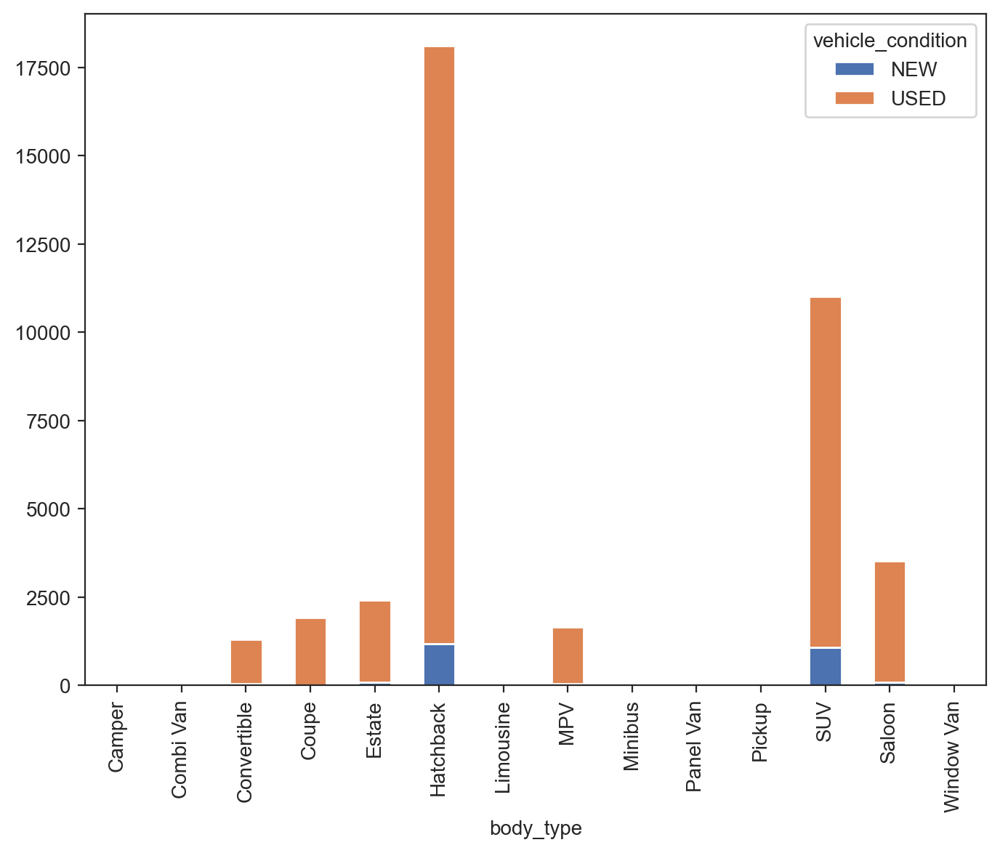

In [135]:
dss.groupby( ['body_type', 'vehicle_condition']).size().unstack('vehicle_condition').plot.bar(stacked=True)

The above stacked bar plot shows us how many new cars and how many used cars are available in the database.